In [1]:
pip install torchsummary



SyntaxError: invalid syntax (1133505105.py, line 1)

In [23]:
import torch
import torch.nn as nn
from torchvision.models import AlexNet
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import os
from torchsummary import summary


In [24]:
# Create a folder to save feature maps
output_folder = 'feature_maps_alexnet_2'
os.makedirs(output_folder, exist_ok=True)

In [25]:
# Create a folder to save filter visualizations
output_folder_filter= 'filter_visualizations_2'
os.makedirs(output_folder_filter, exist_ok=True)



In [31]:
# Create a folder to save filter visualizations
output_folder_mxpool= 'feature_maps_2_mxpool'
os.makedirs(output_folder_mxpool, exist_ok=True)


In [26]:
# Load the pre-trained AlexNet model with ImageNet weights
alexnet = AlexNet()

# Print the architecture of the pre-trained AlexNet model
print(alexnet)



AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [27]:
summary(alexnet, (3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 55, 55]          23,296
              ReLU-2           [-1, 64, 55, 55]               0
         MaxPool2d-3           [-1, 64, 27, 27]               0
            Conv2d-4          [-1, 192, 27, 27]         307,392
              ReLU-5          [-1, 192, 27, 27]               0
         MaxPool2d-6          [-1, 192, 13, 13]               0
            Conv2d-7          [-1, 384, 13, 13]         663,936
              ReLU-8          [-1, 384, 13, 13]               0
            Conv2d-9          [-1, 256, 13, 13]         884,992
             ReLU-10          [-1, 256, 13, 13]               0
           Conv2d-11          [-1, 256, 13, 13]         590,080
             ReLU-12          [-1, 256, 13, 13]               0
        MaxPool2d-13            [-1, 256, 6, 6]               0
AdaptiveAvgPool2d-14            [-1, 25

In [28]:
# Set the model to evaluation mode
alexnet.eval()

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [29]:


# Load and preprocess an example image
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])
image_path = 'beagle.jpg'
image = transform(Image.open(image_path)).unsqueeze(0)



In [30]:

# Define a function to hook into the chosen layer and extract feature maps
activation = {}

def hook_fn(module, input, output):
    activation['value'] = output

    
    
    
#hook = target_layer.register_forward_hook(hook_fn)

# Choose a specific layer for feature map visualization
#target_layer = alexnet.features[8]  # You can choose a different layer index









# Forward pass to get the feature maps
#with torch.no_grad():
 #   alexnet(image)

# Detach the hook
#hook.remove()

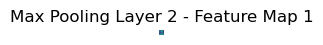

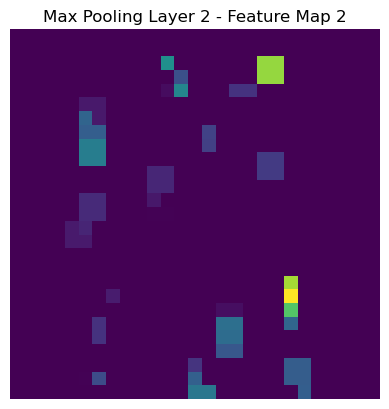

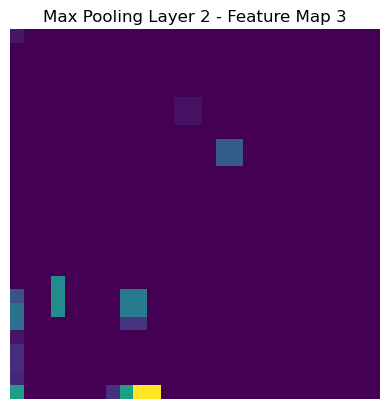

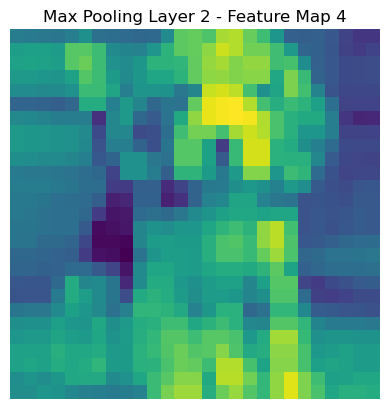

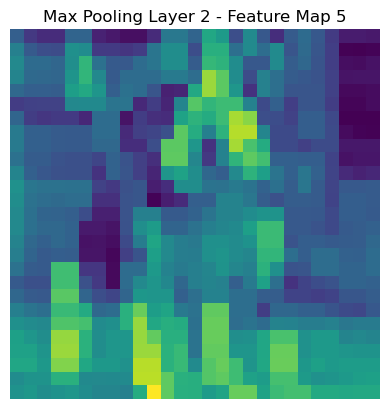

...

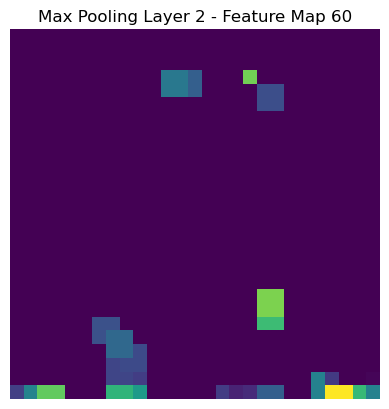

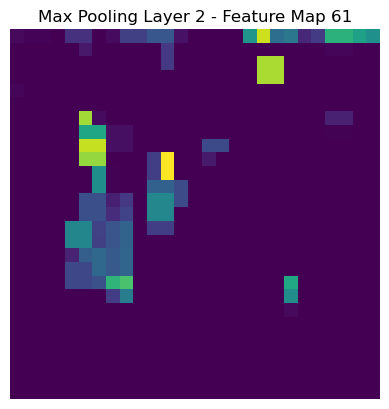

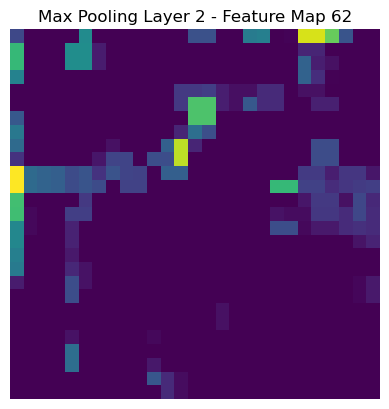

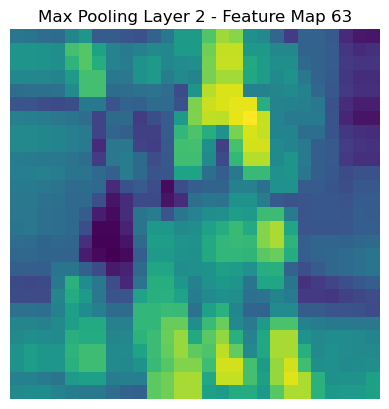

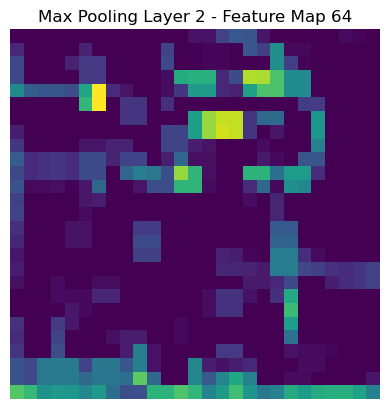

In [36]:
# Layer 2: Max Pooling
layer = alexnet.features[2]
hook = layer.register_forward_hook(hook_fn)
with torch.no_grad():
    alexnet(image)
feature_maps = activation['value'][0].detach()
num_feature_maps = feature_maps.size(0)
plt.subplot(num_feature_maps, 1, 1)
for i in range(num_feature_maps):
    feature_map_image = feature_maps[i].cpu().numpy()
    image_path = os.path.join(output_folder_mxpool, f'{layer_name}_feature_map_{i + 1}.png')
    plt.imsave(image_path, feature_map_image, cmap='viridis')
    
    plt.imshow(feature_maps[i], cmap='viridis')
    plt.title(f'Max Pooling Layer 2 - Feature Map {i + 1}')
    plt.axis('off')
    plt.show()
hook.remove()

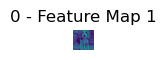

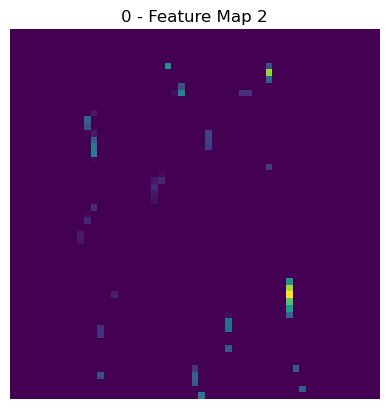

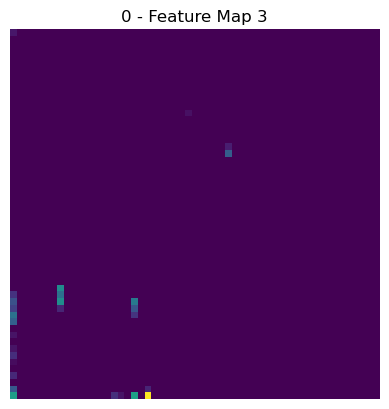

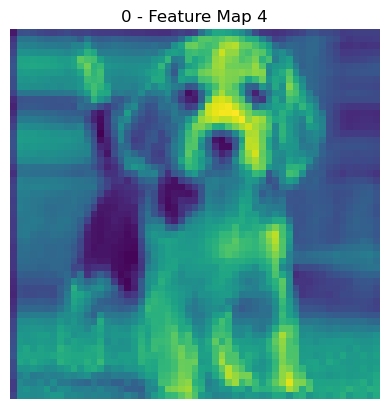

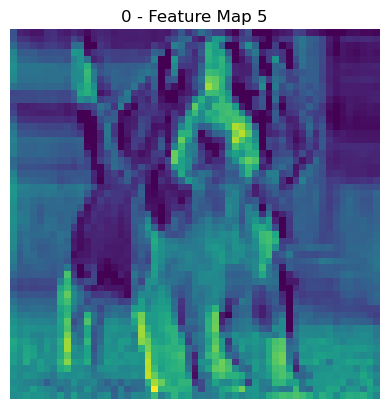

...

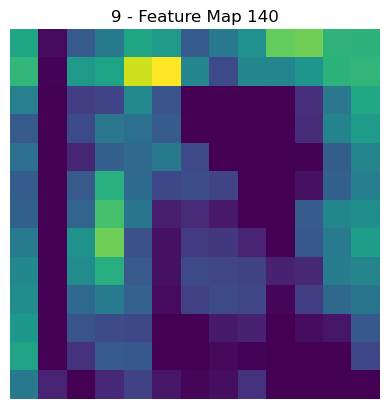

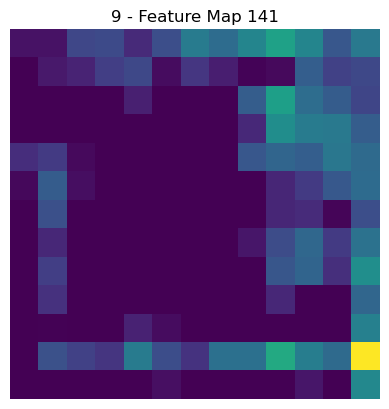

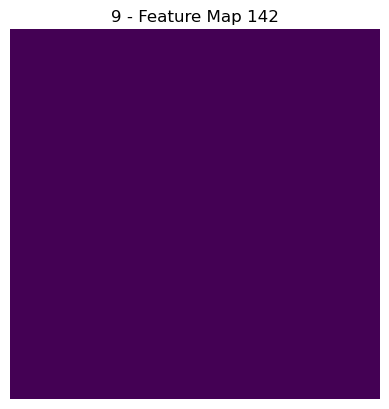

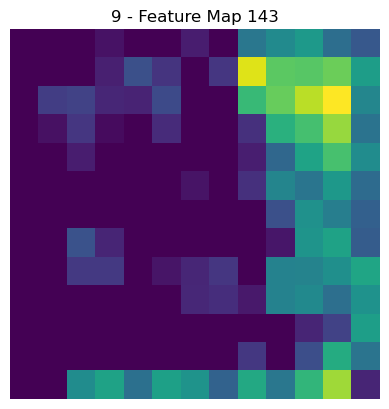

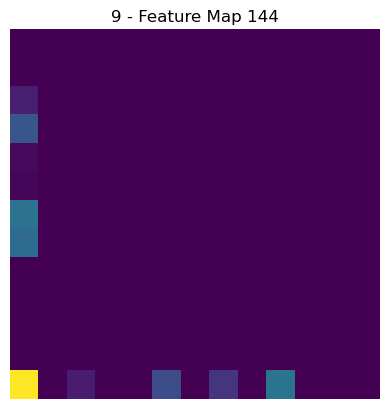

In [37]:
# Visualize feature maps for each layer
plt.figure(figsize=(20, 20))
for layer_name, layer in alexnet.features._modules.items():
    hook = layer.register_forward_hook(hook_fn)
    
    with torch.no_grad():
        alexnet(image)
    
    feature_maps = activation['value'][0].detach()
    num_feature_maps = feature_maps.size(0)
    
    # Display feature maps in a grid for the current layer
    plt.subplot(num_feature_maps, 1, 1)
    for i in range(num_feature_maps):
        feature_map_image = feature_maps[i].cpu().numpy()
        image_path = os.path.join(output_folder, f'{layer_name}_feature_map_{i + 1}.png')
        plt.imsave(image_path, feature_map_image, cmap='viridis')
        
        plt.imshow(feature_maps[i], cmap='viridis')
        plt.title(f'{layer_name} - Feature Map {i + 1}')
        plt.axis('off')
        plt.show()
    
    hook.remove()

In [38]:
# Loop through each layer to visualize and save filters
for layer_name, layer in alexnet.features._modules.items():
    if isinstance(layer, nn.Conv2d):
        filters = layer.weight.data.cpu().numpy()
        
        # Visualize and save each filter
        for i in range(filters.shape[0]):
            filter_image = filters[i, 0].squeeze()
            plt.imshow(filter_image, cmap='gray')
        
            plt.title(f'{layer_name} - Filter {i + 1}')
            plt.axis('off')
            
            # Save each filter as an image
            image_path = os.path.join(output_folder_filter, f'{layer_name}_filter_{i + 1}.png')
            plt.savefig(image_path)
            plt.clf()  # Clear the current figure for the next iteration

<Figure size 640x480 with 0 Axes>

In [32]:
# Visualize the feature maps
feature_maps = activation['value'][0].detach()

plt.figure(figsize=(20,20))
for i in range(feature_maps.size(0)):
    plt.subplot(16, feature_maps.size(0)//16, i + 1)
    plt.imshow(feature_maps[i], cmap='viridis')
    plt.title(f'{i + 1}')
    plt.axis('off')
plt.show()

In [25]:
# Extract the weights from the first convolutional layer
first_conv_layer_weights = alexnet.features[3].weight.data

# Visualize the filters
plt.figure(figsize=(15, 7))

for i in range(first_conv_layer_weights.size(0)):
    plt.subplot(8, 8, i + 1)
    plt.imshow(first_conv_layer_weights[i, 0].detach(), cmap='gray')
    plt.axis('off')
    plt.title(f'Filter {i + 1}')

plt.show()

ValueError: num must be 1 <= num <= 64, not 65

In [79]:
# Determine the number of neurons in the first linear layer
num_neurons = alexnet.classifier[6].in_features

# Extract weights from the first linear layer
linear_layer_weights = alexnet.classifier[6].weight.data

print(num_neurons)


print(len(linear_layer_weights))
# Visualize the weights

plt.figure(figsize=(60, 28))

for i in range(min(num_neurons, 1000)):
    plt.subplot(8, 8, i + 1)
    plt.imshow(linear_layer_weights[i].cpu().numpy().reshape(1, -1), cmap='viridis', aspect='auto')
    plt.title(f'Neuron {i + 1}')
    plt.axis('off')

plt.show()

4096
1000


ValueError: num must be 1 <= num <= 64, not 65

In [71]:
# İlk tam bağlantılı katmandan ağırlıkları çıkar
linear_layer_weights = alexnet.classifier[1].weight.data

# Ağırlıkları görselleştir


num_neurons = linear_layer_weights.size(0)
print(num_neurons)
num_rows = (num_neurons // 8) + 1  # 8 sütunlu bir grid
print(num_rows)
num_cols = 8

plt.figure(figsize=(15, 7))
for i in range(num_neurons):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(linear_layer_weights[i].cpu().numpy().reshape(1, -1), cmap='viridis', aspect='auto')
  #  plt.title(f'Nöron {i + 1}')
    plt.axis('off')

plt.show()

4096
513


In [82]:
# İlk tam bağlantılı katmandan ağırlıkları çıkar
linear_layer_weights = alexnet.classifier[6].weight.data

# Ağırlıkları görselleştir


num_neurons = linear_layer_weights.size(0)
print(num_neurons)

num_rows = (num_neurons // 10) + 1  # 8 sütunlu bir grid
print(num_rows)
num_cols = 10

plt.figure(figsize=(60, 28))
for i in range(num_neurons):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(linear_layer_weights[i].cpu().numpy().reshape(1, -1), cmap='viridis', aspect='auto')
    plt.title(f'{i + 1}')
    plt.axis('off')

plt.show()

1000
101
